# The Continuous Thought Machine – Tutorial 02: Inference [![Open in Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/SakanaAI/continuous-thought-machines/blob/main/examples/02_inference.ipynb) [![arXiv](https://img.shields.io/badge/arXiv-2505.05522-b31b1b.svg)](https://arxiv.org/abs/2505.05522)

In this tutorial, we walk through an example of loading a pretrained CTM and using it for inference. Specifically, we'll download a CTM trained on ImageNet, and use it for inference.

### Installation

We start by assuming the CTM repo has not yet been cloned (for example, if using Colab), and so we clone the CTM repo. We also install mediapy for vizualizing gifs and gdown for downloading the model checkpoint from Google Drive.

In [1]:
!pip install mediapy
!git clone https://github.com/SakanaAI/continuous-thought-machines.git
!pip install gdown

fatal: destination path 'continuous-thought-machines' already exists and is not an empty directory.


Next, we download the CTM checkpoint from [Google Drive](https://drive.google.com/file/d/1Lr_3RZU9X9SS8lBhAhECBiSZDKfKhDkJ/view?usp=drive_link), and unzip it.

In [2]:
!gdown https://drive.google.com/uc?id=1Lr_3RZU9X9SS8lBhAhECBiSZDKfKhDkJ
!unzip  imagenet.zip
CHECKPOINT_PATH = "imagenet/ctm_imagenet_D=4096_T=50_M=25.pt"

Downloading...
From (original): https://drive.google.com/uc?id=1Lr_3RZU9X9SS8lBhAhECBiSZDKfKhDkJ
From (redirected): https://drive.google.com/uc?id=1Lr_3RZU9X9SS8lBhAhECBiSZDKfKhDkJ&confirm=t&uuid=297895e4-ee0f-4e02-a780-30babe871408
To: /mnt/c/Users/YSK_lab/Documents/Sakana AI/task 3 CTM/continuous-thought-machines/examples/imagenet.zip
100%|████████████████████████████████████████| 691M/691M [00:41<00:00, 16.7MB/s]
Archive:  imagenet.zip
replace __MACOSX/._imagenet? [y]es, [n]o, [A]ll, [N]one, [r]ename: ^C


### Imports

In [ ]:
import sys
sys.path.append("continuous-thought-machines")

import torch
import matplotlib.pyplot as plt
from PIL import Image
from torchvision import transforms
from models.ctm import ContinuousThoughtMachine as CTM
import urllib
from IPython.display import Image as IPyImage, display
from pprint import pprint
import numpy as np
import seaborn as sns
import os
import torch.nn.functional as F
from matplotlib import patheffects
from scipy import ndimage
import imageio
import mediapy
from tasks.image_classification.plotting import plot_neural_dynamics
from tasks.image_classification.imagenet_classes import IMAGENET2012_CLASSES

import glob

/home/archy/anaconda3/envs/ctm/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


### Load the Model

In [4]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
checkpoint = torch.load(CHECKPOINT_PATH, map_location=device, weights_only=False)

# The args used for instantiating the model
model_args = checkpoint['args']

We can see what hyperparameters were used with this CTM

In [ ]:
pprint(vars(model_args))

{'backbone_type': 'resnet152-4',
 'd_input': 1024,
 'd_model': 4096,
 'deep_memory': True,
 'do_normalisation': False,
 'heads': 16,
 'iterations': 50,
 'memory_hidden_dims': 64,
 'memory_length': 25,
 'n_random_pairing_self': 32,
 'n_synch_action': 2048,
 'n_synch_out': 8196,
 'neuron_select_type': 'random-pairing',
 'out_dims': 1000,
 'positional_embedding_type': 'none',
 'synapse_depth': 8}


This tell us that the CTM has:
- 4096 neurons
- 50 internal ticks
- 25 memory length
- 8196 pairs of neurons are used for synchronization
- Uses a ResNet backbone (preprocessor)

In [6]:
model = CTM(
    iterations=model_args.iterations,
    d_model=model_args.d_model,
    d_input=model_args.d_input,
    heads=model_args.heads,
    n_synch_out=model_args.n_synch_out,
    n_synch_action=model_args.n_synch_action,
    synapse_depth=model_args.synapse_depth,
    memory_length=model_args.memory_length,
    deep_nlms=model_args.deep_memory,
    memory_hidden_dims=model_args.memory_hidden_dims,
    do_layernorm_nlm=model_args.do_normalisation,
    backbone_type=model_args.backbone_type,
    positional_embedding_type=model_args.positional_embedding_type,
    out_dims=model_args.out_dims,
    prediction_reshaper=[-1],
    dropout=0,
    neuron_select_type=model_args.neuron_select_type,
    n_random_pairing_self=model_args.n_random_pairing_self,
).to(device)

load_result = model.load_state_dict(checkpoint['model_state_dict'], strict=False)
model.eval(); # Set model to evaluation mode

Using neuron select type: random-pairing
Synch representation size action: 2048
Synch representation size out: 8196


## Goldfish example

### Load image

Next we will download an image to do inference with.

In [26]:
# url = "https://www.seahorseaquariums.com/image/cache/catalog/Categories%20-%20Freshewater/Coldwater%20Fish/Fantails/Fantail%20Goldfish-2000x2000.jpg"
# filename="goldfish.jpg"
target=1 # Goldfish corresponds to index 1 in IMAGENET2012_CLASSES
# urllib.request.urlretrieve(url, filename) # Download the image
image = Image.open("images4inference/goldfish.jpg").convert("RGB")
# display(image)

We resize, crop and normalize the image, and convert into a PyTorch tensor.

In [9]:
dataset_mean = [0.485, 0.456, 0.406]
dataset_std = [0.229, 0.224, 0.225]
transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(
        mean=dataset_mean,
        std=dataset_std
    )
])

input_tensor = transform(image).unsqueeze(0).to(device)

### Running Inference

Lets run a forward pass on the model to get the CTMs prediction, as well as some tensors that we will use for visualization.

Specifically, the model outputs:
- `predictions` (torch.Tensor): logits at each internal tick (Shape: B, C, T)
- `certainties` (torch.Tensor): 1 - normalized entropy at each internal tick (Shape: B, 2, T)
- `synchronization` (tuple(np.array)): a tuple containing the synch represenations over time for both actions and outputs (Shape of each: T, B, synch_rep_size)
- `pre_activations` (np.array): the history of neuron pre-activations (after synapses, before NLMs) (Shape: T, B, d_model)
- `post_activations` (np.array): the history of neuron post-activations (after NLMs) (Shape: T, B, d_model)
- `attention_tracking` (np.array): a tensor containing the attention weights (Shape: T, B, num_heads, target_seq_length=1, source_seq_length=196)


In [10]:
predictions, certainties, synchronization, pre_activations, post_activations, attention_tracking = model(input_tensor, track=True)

Lets see what the CTM predicted at 1) the final internal tick and 2) the internal tick with highest certainty

In [15]:
# 1) Prediction at final interal tick
prediction_last = predictions[0, :, -1].argmax(dim=0)
IMAGENET_CLASS_LIST = list(IMAGENET2012_CLASSES.values())

print(f"Target Class: {target} = {IMAGENET_CLASS_LIST[target]}")
print(f"Predicted Class (final): {prediction_last.item()} = {IMAGENET_CLASS_LIST[prediction_last.item()]}")

# 2) Certainty at most certain internal tick
where_most_certain = certainties[:,1].argmax(-1)
B = 1
prediction_most_certain = predictions.argmax(1)[torch.arange(B, device=predictions.device),where_most_certain]
print(f"Predicted Class (most certain): {prediction_most_certain.item()} = {IMAGENET_CLASS_LIST[prediction_most_certain.item()]}")

Target Class: 1 = goldfish, Carassius auratus
Predicted Class (final): 1 = goldfish, Carassius auratus
Predicted Class (most certain): 1 = goldfish, Carassius auratus


### Function to make GIFS

Next, we write a function to make pretty gifs.

In [16]:
def make_gif(predictions, certainties, attention_tracking, ground_truth_target, out_path, dataset_mean, dataset_std):

    def find_island_centers(array_2d, threshold):
        """
        Finds the center of mass of each island (connected component > threshold)
        in a 2D array, weighted by the array's values.
        Returns list of (y, x) centers and list of areas.
        """
        binary_image = array_2d > threshold
        labeled_image, num_labels = ndimage.label(binary_image)
        centers = []
        areas = []
        # Calculate center of mass for each labeled island (label 0 is background)
        for i in range(1, num_labels + 1):
            island_mask = (labeled_image == i)
            total_mass = np.sum(array_2d[island_mask])
            if total_mass > 0:
                # Get coordinates for this island
                y_coords, x_coords = np.mgrid[:array_2d.shape[0], :array_2d.shape[1]]
                # Calculate weighted average for center
                x_center = np.average(x_coords[island_mask], weights=array_2d[island_mask])
                y_center = np.average(y_coords[island_mask], weights=array_2d[island_mask])
                centers.append((round(y_center, 4), round(x_center, 4)))
                areas.append(np.sum(island_mask)) # Area is the count of pixels in the island
        return centers, areas

    interp_mode = 'nearest'
    figscale = 0.85

    class_labels = list(IMAGENET2012_CLASSES.values()) # Load actual class names

    # predictions: (B, Classes, Steps), attention_tracking: (Steps*B*Heads, SeqLen)
    n_steps = predictions.size(-1)

    # --- Reshape Attention ---
    # Infer feature map size from model internals (assuming B=1)
    h_feat, w_feat = model.kv_features.shape[-2:]

    n_heads = attention_tracking.shape[2] 
    # Reshape to (Steps, Heads, H_feat, W_feat) assuming B=1
    attention_tracking = attention_tracking.reshape(n_steps, n_heads, h_feat, w_feat)

    # --- Setup for Plotting ---
    step_linspace = np.linspace(0, 1, n_steps) # For step colors
    # Define color maps
    cmap_spectral = sns.color_palette("Spectral", as_cmap=True)
    cmap_attention = sns.color_palette('viridis', as_cmap=True)

    # Create output directory for this index
    index_output_dir = os.path.join(out_path, str(0))
    os.makedirs(index_output_dir, exist_ok=True)

    frames = [] # Store frames for GIF
    head_routes = {h: [] for h in range(n_heads)} # Store (y,x) path points per head
    head_routes[-1] = []
    route_colours_step = [] # Store colors for each step's path segments

    # --- Loop Through Each Step ---
    for step_i in range(n_steps):

        # --- Prepare Image for Display ---
        # Denormalize the input tensor for visualization
        data_img_tensor = input_tensor[0].cpu() # Get first item in batch, move to CPU
        mean_tensor = torch.tensor(dataset_mean).view(3, 1, 1)
        std_tensor = torch.tensor(dataset_std).view(3, 1, 1)
        data_img_denorm = data_img_tensor * std_tensor + mean_tensor
        # Permute to (H, W, C) and convert to numpy, clip to [0, 1]
        data_img_np = data_img_denorm.permute(1, 2, 0).detach().numpy()
        data_img_np = np.clip(data_img_np, 0, 1)
        img_h, img_w = data_img_np.shape[:2]

        # --- Process Attention & Certainty ---
        # Average attention over last few steps (from original code)
        start_step = max(0, step_i - 5)
        attention_now = attention_tracking[start_step : step_i + 1].mean(0) # Avg over steps -> (Heads, H_feat, W_feat)
        # Get certainties up to current step
        certainties_now = certainties[0, 1, :step_i+1].detach().cpu().numpy() # Assuming index 1 holds relevant certainty

        # --- Calculate Attention Paths (using bilinear interp) ---
        # Interpolate attention to image size using bilinear for center finding
        attention_interp_bilinear = F.interpolate(
            torch.from_numpy(attention_now).unsqueeze(0).float(), # Add batch dim, ensure float
            size=(img_h, img_w),
            mode=interp_mode,
            # align_corners=False
        ).squeeze(0) # Remove batch dim -> (Heads, H, W)

        # Normalize each head's map to [0, 1]
        # Deal with mean
        attn_mean = attention_interp_bilinear.mean(0)
        attn_mean_min = attn_mean.min()
        attn_mean_max = attn_mean.max()
        attn_mean = (attn_mean - attn_mean_min) / (attn_mean_max - attn_mean_min)
        centers, areas = find_island_centers(attn_mean.detach().cpu().numpy(), threshold=0.7)

        if centers: # If islands found
            largest_island_idx = np.argmax(areas)
            current_center = centers[largest_island_idx] # (y, x)
            head_routes[-1].append(current_center)
        elif head_routes[-1]: # If no center now, repeat last known center if history exists
            head_routes[-1].append(head_routes[-1][-1])


        attn_min = attention_interp_bilinear.view(n_heads, -1).min(dim=-1, keepdim=True)[0].unsqueeze(-1)
        attn_max = attention_interp_bilinear.view(n_heads, -1).max(dim=-1, keepdim=True)[0].unsqueeze(-1)
        attention_interp_bilinear = (attention_interp_bilinear - attn_min) / (attn_max - attn_min + 1e-6)

        # Store step color
        current_colour = list(cmap_spectral(step_linspace[step_i]))
        route_colours_step.append(current_colour)

        # Find island center for each head
        for head_i in range(n_heads):
            attn_head_np = attention_interp_bilinear[head_i].detach().cpu().numpy()
            # Keep threshold=0.7 based on original call
            centers, areas = find_island_centers(attn_head_np, threshold=0.7)

            if centers: # If islands found
                largest_island_idx = np.argmax(areas)
                current_center = centers[largest_island_idx] # (y, x)
                head_routes[head_i].append(current_center)
            elif head_routes[head_i]: # If no center now, repeat last known center if history exists
                    head_routes[head_i].append(head_routes[head_i][-1])
        
                

        # --- Plotting Setup ---
        mosaic = [['head_mean', 'head_mean', 'head_mean', 'head_mean', 'head_mean_overlay', 'head_mean_overlay', 'head_mean_overlay', 'head_mean_overlay'],
                    ['head_mean', 'head_mean', 'head_mean', 'head_mean', 'head_mean_overlay', 'head_mean_overlay', 'head_mean_overlay', 'head_mean_overlay'],
                    ['head_mean', 'head_mean', 'head_mean', 'head_mean', 'head_mean_overlay', 'head_mean_overlay', 'head_mean_overlay', 'head_mean_overlay'],
                    ['head_mean', 'head_mean', 'head_mean', 'head_mean', 'head_mean_overlay', 'head_mean_overlay', 'head_mean_overlay', 'head_mean_overlay'],
                ['head_0', 'head_0_overlay', 'head_1', 'head_1_overlay', 'head_2', 'head_2_overlay', 'head_3', 'head_3_overlay'],
                ['head_4', 'head_4_overlay', 'head_5', 'head_5_overlay','head_6', 'head_6_overlay', 'head_7', 'head_7_overlay'],
                ['head_8', 'head_8_overlay', 'head_9', 'head_9_overlay','head_10', 'head_10_overlay', 'head_11', 'head_11_overlay'],
                ['head_12', 'head_12_overlay', 'head_13', 'head_13_overlay','head_14', 'head_14_overlay', 'head_15', 'head_15_overlay'],
                ['probabilities', 'probabilities','probabilities', 'probabilities', 'certainty', 'certainty', 'certainty', 'certainty'],
                ]

        img_aspect = data_img_np.shape[0] / data_img_np.shape[1]
        aspect_ratio = (8 * figscale, 9 * figscale * img_aspect) # W, H
        fig, axes = plt.subplot_mosaic(mosaic, figsize=aspect_ratio)

        for ax in axes.values():
            ax.axis('off')

        # --- Plot Certainty ---
        ax_cert = axes['certainty']
        ax_cert.plot(np.arange(len(certainties_now)), certainties_now, 'k-', linewidth=figscale*1)
        # Add background color based on prediction correctness at each step
        for ii in range(len(certainties_now)):
            is_correct = predictions[0, :, ii].argmax(-1).item() == ground_truth_target # .item() for scalar tensor
            facecolor = 'limegreen' if is_correct else 'orchid'
            ax_cert.axvspan(ii, ii + 1, facecolor=facecolor, edgecolor=None, lw=0, alpha=0.3)
        # Mark the last point
        ax_cert.plot(len(certainties_now)-1, certainties_now[-1], 'k.', markersize=figscale*4)
        ax_cert.axis('off')
        ax_cert.set_ylim([0.05, 1.05])
        ax_cert.set_xlim([0, n_steps]) # Use n_steps for consistent x-axis limit

        # --- Plot Probabilities ---
        ax_prob = axes['probabilities']
        # Get probabilities for the current step
        ps = torch.softmax(predictions[0, :, step_i], -1).detach().cpu()
        k = 5 # Top k predictions
        topk_probs, topk_indices = torch.topk(ps, k, dim=0, largest=True)
        topk_indices = topk_indices.numpy()
        topk_probs = topk_probs.numpy()

        true_class_idx = ground_truth_target # Ground truth index

        # Determine bar colors (green if correct, blue otherwise - consistent with original)
        colours = ['g' if idx == true_class_idx else 'b' for idx in topk_indices]

        # Plot horizontal bars (inverted range for top-down display)
        ax_prob.barh(np.arange(k)[::-1], topk_probs, color=colours, alpha=1) # Use barh and inverted range
        ax_prob.set_xlim([0, 1])
        ax_prob.axis('off')

        # Add text labels for top classes
        for i, name_idx in enumerate(topk_indices):
            name = class_labels[name_idx] # Get name from index
            is_correct = name_idx == true_class_idx
            fg_color = 'darkgreen' if is_correct else 'crimson' # Text colors from original
            text_str = f'{name[:40]}' # Truncate long names
            # Position text on the left side of the horizontal bars
            ax_prob.text(
                0.01, # Small offset from left edge
                k - 1 - i, # Y-position corresponding to the bar
                text_str,
                #transform=ax_prob.transAxes, # Use data coordinates for Y
                verticalalignment='center',
                horizontalalignment='left',
                fontsize=8,
                color=fg_color,
                alpha=0.9, # Slightly more visible than 0.5
                path_effects=[
                    patheffects.Stroke(linewidth=2, foreground='white'), # Adjusted stroke
                    patheffects.Normal()
                ])


        # --- Plot Attention Heads & Overlays (using nearest interp) ---
        # Re-interpolate attention using nearest neighbor for visual plotting
        attention_interp_plot = F.interpolate(
            torch.from_numpy(attention_now).unsqueeze(0).float(),
            size=(img_h, img_w),
            mode=interp_mode, # 'nearest'
        ).squeeze(0)

        attn_mean = attention_interp_plot.mean(0)
        attn_mean_min = attn_mean.min()
        attn_mean_max = attn_mean.max()
        attn_mean = (attn_mean - attn_mean_min) / (attn_mean_max - attn_mean_min)


        # Normalize each head's map to [0, 1]
        attn_min_plot = attention_interp_plot.view(n_heads, -1).min(dim=-1, keepdim=True)[0].unsqueeze(-1)
        attn_max_plot = attention_interp_plot.view(n_heads, -1).max(dim=-1, keepdim=True)[0].unsqueeze(-1)
        attention_interp_plot = (attention_interp_plot - attn_min_plot) / (attn_max_plot - attn_min_plot + 1e-6)
        attention_interp_plot_np = attention_interp_plot.detach().cpu().numpy()
        


        


        for head_i in list(range(n_heads)) + [-1]:
            axname = f'head_{head_i}' if head_i != -1 else 'head_mean'
            if axname not in axes: continue # Skip if mosaic doesn't have this head

            ax = axes[axname]
            ax_overlay = axes[f'{axname}_overlay']

            # Plot attention heatmap
            this_attn = attention_interp_plot_np[head_i] if head_i != -1 else attn_mean
            img_to_plot = cmap_attention(this_attn)
            ax.imshow(img_to_plot)
            ax.axis('off')

            # Plot overlay: image + paths
            these_route_steps = head_routes[head_i]
            arrow_scale = 1.5 if head_i != -1 else 3

            if these_route_steps: # Only plot if path exists
                # Separate y and x coordinates
                y_coords, x_coords = zip(*these_route_steps)
                y_coords = np.array(y_coords)
                x_coords = np.array(x_coords)

                # Flip y-coordinates for correct plotting (imshow origin is top-left)
                # NOTE: Original flip seemed complex, simplifying to standard flip
                y_coords_flipped = img_h - 1 - y_coords

                # Show original image flipped vertically to match coordinate system
                ax_overlay.imshow(np.flipud(data_img_np), origin='lower')

                # Draw arrows for path segments
                    # Arrow size scaling from original
                for i in range(len(these_route_steps) - 1):
                    dx = x_coords[i+1] - x_coords[i]
                    dy = y_coords_flipped[i+1] - y_coords_flipped[i] # Use flipped y for delta

                    # Draw white background arrow (thicker)
                    ax_overlay.arrow(x_coords[i], y_coords_flipped[i], dx, dy,
                                        linewidth=1.6 * arrow_scale * 1.3,
                                        head_width=1.9 * arrow_scale * 1.3,
                                        head_length=1.4 * arrow_scale * 1.45,
                                        fc='white', ec='white', length_includes_head=True, alpha=1)
                    # Draw colored foreground arrow
                    ax_overlay.arrow(x_coords[i], y_coords_flipped[i], dx, dy,
                                        linewidth=1.6 * arrow_scale,
                                        head_width=1.9 * arrow_scale,
                                        head_length=1.4 * arrow_scale,
                                        fc=route_colours_step[i], ec=route_colours_step[i], # Use step color
                                        length_includes_head=True)

            else: # If no path yet, just show the image
                    ax_overlay.imshow(np.flipud(data_img_np), origin='lower')


            # Set limits and turn off axes for overlay
            ax_overlay.set_xlim([0, img_w - 1])
            ax_overlay.set_ylim([0, img_h - 1])
            ax_overlay.axis('off')
        

        # --- Finalize and Save Frame ---
        fig.tight_layout(pad=0.1) # Adjust spacing

        # Render the plot to a numpy array
        canvas = fig.canvas
        canvas.draw()
        image_numpy = np.frombuffer(canvas.buffer_rgba(), dtype='uint8')
        image_numpy = image_numpy.reshape(*reversed(canvas.get_width_height()), 4)[:,:,:3] # Get RGB

        frames.append(image_numpy) # Add to list for GIF

        

        plt.close(fig) # Close figure to free memory

    # --- Save GIF ---
    gif_path = os.path.join(out_path, f'{str(0)}_viz.gif')
    print(f"Saving GIF to {gif_path}...")
    mediapy.show_video(frames, width=400, codec="gif")
    imageio.mimsave(gif_path, frames, fps=15, loop=0) # loop=0 means infinite loop
    pass

### Make GIF and plot neural dynamics

Saving GIF to 02_output/0_viz.gif...


""

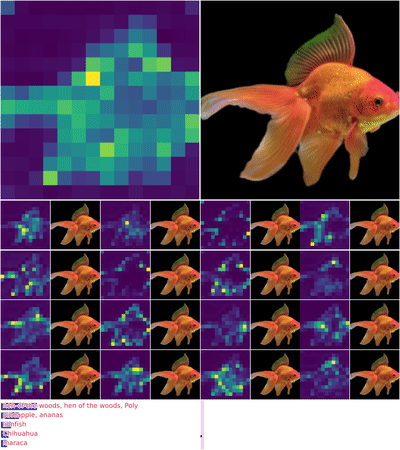

In [17]:
# Make an output folder 
out_path = "02_output"
os.makedirs(out_path, exist_ok=True)
make_gif(predictions, certainties, attention_tracking, target, out_path, dataset_mean, dataset_std)

We can also visualise the dynamics of the neurons using the plot_neural_dynamics function defined in the CTM repo.

In [18]:
plot_neural_dynamics(post_activations, 15*10, out_path, axis_snap=True, N_per_row=15)

(<Figure size 1800x400 with 150 Axes>,
 <Figure size 3600x800 with 150 Axes>,
 array([3020,  262, 2584,  848, 2139, 1739,  675,  791,  916,  756, 3187,
         924,  258, 1556, 1632, 4060, 1670, 1149, 3998, 3614, 1324, 2423,
         820, 1872, 2065, 1967, 1176, 3358, 1984, 1924,   43, 1966, 2186,
        2799, 1012, 2552, 2049, 1881, 3990, 1733,   99, 1424, 1233, 1411,
        2706, 2984, 2581, 2614, 3922, 1279, 1019, 3007, 3078, 2357, 2507,
        1030, 2240, 1911, 2901, 2805, 1405, 2824,  178, 2561, 2467, 3853,
         668, 2620, 2502, 3173, 2394,  179, 3236,  109,  610, 1707, 2849,
        3929,  883, 3807,  214, 2218, 2800,  558, 3348, 3860, 2694, 4066,
         852, 3156, 2902,  188, 1299, 2830, 1439,  295, 2865, 1780, 1816,
        1987, 3904, 3171, 4065, 1103, 1002,  293, 2244, 3894, 3944, 2188,
        1814, 1719, 3022, 2712, 1144, 4025, 1238, 2612, 1026,   31, 3722,
        2921, 3109, 3451, 1592, 1361, 3193, 3548, 2388, 1850, 1667, 1743,
        3589, 3311, 2856, 1427,  3

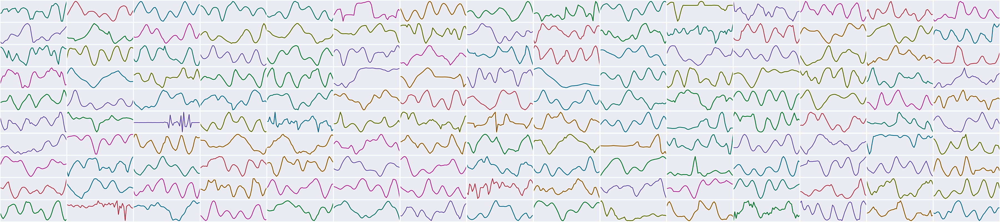

In [19]:
display(IPyImage(filename=f'{out_path}/neural_dynamics_synch.png'))

## Loop through different images

### Test with a single image

In [ ]:
image = Image.open("./images4inference/goldfish.jpg").convert("RGB")
display(image)

predictions, certainties, synchronization, pre_activations, post_activations, attention_tracking = model(input_tensor, track=True)


# 1) Prediction at final interal tick
prediction_last = predictions[0, :, -1].argmax(dim=0)
IMAGENET_CLASS_LIST = list(IMAGENET2012_CLASSES.values())

print(f"Target Class: {target} = {IMAGENET_CLASS_LIST[target]}")
print(f"Predicted Class (final): {prediction_last.item()} = {IMAGENET_CLASS_LIST[prediction_last.item()]}")

# 2) Certainty at most certain internal tick
where_most_certain = certainties[:,1].argmax(-1)
B = 1
prediction_most_certain = predictions.argmax(1)[torch.arange(B, device=predictions.device),where_most_certain]
print(f"Predicted Class (most certain): {prediction_most_certain.item()} = {IMAGENET_CLASS_LIST[prediction_most_certain.item()]}")


# Make an output folder 
out_path = "02_output"
os.makedirs(out_path, exist_ok=True)
make_gif(predictions, certainties, attention_tracking, target, out_path, dataset_mean, dataset_std)

### v2.0

Found 6 images in ./images4inference

--- Processing image 1/6: goldfish.jpg ---
Predicted Class (final): 1 = goldfish, Carassius auratus
Predicted Class (most certain): 1 = goldfish, Carassius auratus
Saving GIF to 02_output/goldfish/0_viz.gif...


""

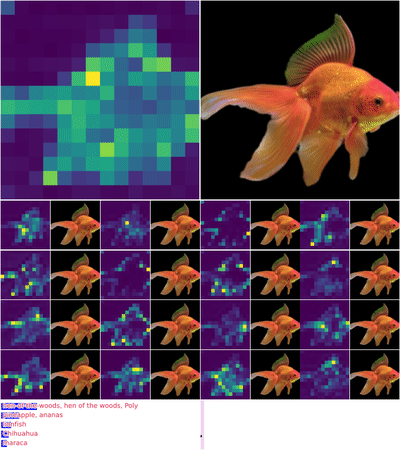

GIF saved to: 02_output/goldfish

--- Processing image 2/6: mammoth1.jpg ---
Predicted Class (final): 101 = tusker
Predicted Class (most certain): 101 = tusker
Saving GIF to 02_output/mammoth1/0_viz.gif...


""

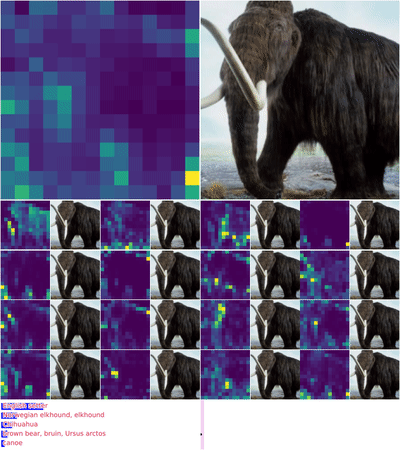

GIF saved to: 02_output/mammoth1

--- Processing image 3/6: mammoth2.jpg ---
Predicted Class (final): 380 = titi, titi monkey
Predicted Class (most certain): 380 = titi, titi monkey
Saving GIF to 02_output/mammoth2/0_viz.gif...


""

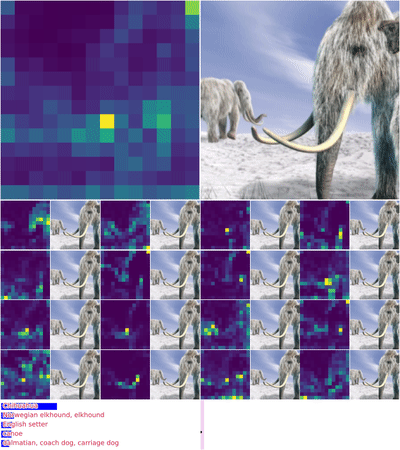

GIF saved to: 02_output/mammoth2

--- Processing image 4/6: noise1.jpg ---
Predicted Class (final): 556 = fire screen, fireguard
Predicted Class (most certain): 899 = water jug
Saving GIF to 02_output/noise1/0_viz.gif...


""

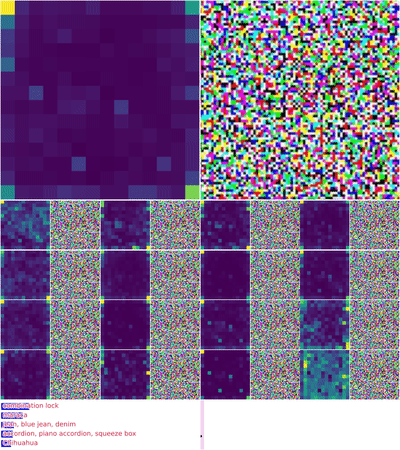

GIF saved to: 02_output/noise1

--- Processing image 5/6: sushi1.jpg ---
Predicted Class (final): 112 = conch
Predicted Class (most certain): 112 = conch
Saving GIF to 02_output/sushi1/0_viz.gif...


""

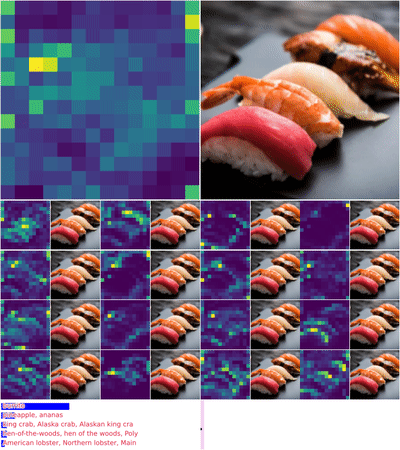

GIF saved to: 02_output/sushi1

--- Processing image 6/6: sushi2.jpg ---
Predicted Class (final): 923 = plate
Predicted Class (most certain): 923 = plate
Saving GIF to 02_output/sushi2/0_viz.gif...


""

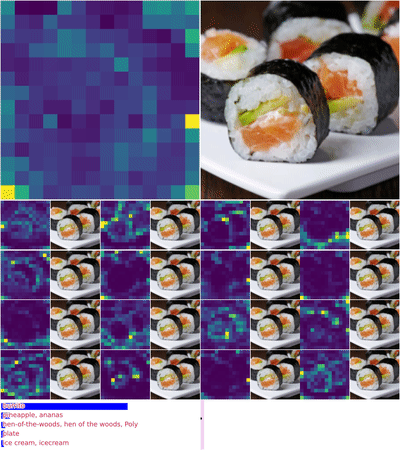

GIF saved to: 02_output/sushi2

Processing complete! All outputs saved to: 02_output


In [28]:
image_folder = "./images4inference"
# image_extensions = ['*.jpg', '*.jpeg', '*.png', '*.bmp', '*.tiff', '*.webp']
image_extensions = ['*.jpg', '*.jpeg', '*.png']
image_paths = []
for ext in image_extensions:
    image_paths.extend(glob.glob(os.path.join(image_folder, ext)))
    image_paths.extend(glob.glob(os.path.join(image_folder, ext.upper())))

image_paths.sort()

print(f"Found {len(image_paths)} images in {image_folder}")

out_path = "02_output"
os.makedirs(out_path, exist_ok=True)

IMAGENET_CLASS_LIST = list(IMAGENET2012_CLASSES.values())

for i, image_path in enumerate(image_paths):
    print(f"\n--- Processing image {i+1}/{len(image_paths)}: {os.path.basename(image_path)} ---")
    
    try:
        image = Image.open(image_path).convert("RGB")
        
        # image_display = image.resize((256, 256), Image.Resampling.LANCZOS)
        # display(image_display)
        
        dataset_mean = [0.485, 0.456, 0.406]
        dataset_std = [0.229, 0.224, 0.225]
        transform = transforms.Compose([
            transforms.Resize(256),
            transforms.CenterCrop(224),
            transforms.ToTensor(),
            transforms.Normalize(
                mean=dataset_mean,
                std=dataset_std
            )
        ])

        input_tensor = transform(image).unsqueeze(0).to(device)
        
        predictions, certainties, synchronization, pre_activations, post_activations, attention_tracking = model(input_tensor, track=True)
        
        prediction_last = predictions[0, :, -1].argmax(dim=0)
        print(f"Predicted Class (final): {prediction_last.item()} = {IMAGENET_CLASS_LIST[prediction_last.item()]}")
        
        where_most_certain = certainties[:,1].argmax(-1)
        B = 1
        prediction_most_certain = predictions.argmax(1)[torch.arange(B, device=predictions.device), where_most_certain]
        print(f"Predicted Class (most certain): {prediction_most_certain.item()} = {IMAGENET_CLASS_LIST[prediction_most_certain.item()]}")
        
        image_name = os.path.splitext(os.path.basename(image_path))[0]
        image_out_path = os.path.join(out_path, image_name)
        os.makedirs(image_out_path, exist_ok=True)
        
        make_gif(predictions, certainties, attention_tracking, None, image_out_path, dataset_mean, dataset_std)
        
        print(f"GIF saved to: {image_out_path}")
        
    except Exception as e:
        print(f"Error processing {image_path}: {str(e)}")
        continue

print(f"\nProcessing complete! All outputs saved to: {out_path}")